<a href="https://colab.research.google.com/github/FaizanHameed1/Object-Detection-Traffic-Signs-Detection-with-YOLO-algorithm-/blob/main/Traffic_Signs_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
import os
#os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"

In [3]:
cd /content/gdrive/My Drive/Kaggle/traffic_signs_detection

/content/gdrive/My Drive/Kaggle/traffic_signs_detection


In [4]:
os.getcwd()

'/content/gdrive/My Drive/Kaggle/traffic_signs_detection'

In [5]:
#downloading dataset in drive
#!kaggle datasets download -d valentynsichkar/traffic-signs-dataset-in-yolo-format

In [6]:
#check the content in the directory
!ls

classes.names	      test.txt			       ts_data.data
data		      Traffic_Signs_Detection_2.ipynb  yolov3_ts_test.cfg
getting-full-path.py  traffic-sign-to-test.mp4	       yolov3_ts_train.cfg
speed_limit5.jpg      train.txt			       yolov5
speed_limit.jpg       ts


In [7]:
#so we have downloaded the dataset(as it is zip file so we are going to extract and delete the old zip file)
#run only one time
#!unzip \*.zip  && rm *.zip

In [8]:
ls

classes.names         test.txt                         ts_data.data
data/                 Traffic_Signs_Detection_2.ipynb  yolov3_ts_test.cfg
getting-full-path.py  traffic-sign-to-test.mp4         yolov3_ts_train.cfg
speed_limit5.jpg      train.txt                        yolov5/
speed_limit.jpg       ts/


In [9]:
#Directory of data
dataset_path="/content/gdrive/My Drive/Kaggle/traffic_signs_detection/ts/ts"

The data in dataset_path directory have two types.With every image there is a text file. At first position in each text file, the class is given and next four are the bounding box coordinates. This is the dataset type which YOLO algorithem takes as input.

In [10]:
from IPython.display import Image, display #to display immages and results
import tensorflow as tf
import torch as tr#yolov5 works on the top of pytorch
import tensorboard as tb
import cv2
import matplotlib.pyplot as plt
import random
%matplotlib inline

In [11]:
pwd #current working drectory

'/content/gdrive/My Drive/Kaggle/traffic_signs_detection'

In [12]:
#cloning the github repository for yolov5
#!git clone https://github.com/ultralytics/yolov5.git

In [13]:
ls #Now we can check that our repositery is downloaded with the name of yolov5

classes.names         test.txt                         ts_data.data
data/                 Traffic_Signs_Detection_2.ipynb  yolov3_ts_test.cfg
getting-full-path.py  traffic-sign-to-test.mp4         yolov3_ts_train.cfg
speed_limit5.jpg      train.txt                        yolov5/
speed_limit.jpg       ts/


In [14]:
%cd yolov5 

/content/gdrive/My Drive/Kaggle/traffic_signs_detection/yolov5


In [ ]:
#we have to install requirements(with name requirements.txt) file that exist in the folder yolov5 with the
#!pip install -U -r requirements.txt

As we can see that our whole data is in single folder so, we have to divide it into train and validation also yolov5 required dataset in this format.We will convert this dataset in four folders i.e in train,validation and train labels and validation labels.

In [ ]:
#first of all we have to split images and text files
images=[]
text_files=[]

for file_ in os.listdir(dataset_path):
  if file_.endswith(".jpg"):

    images.append(file_)
  else: 
    text_files.append(file_)

#total immages and text files
total_images=len(images)
total_annotations=len(text_files)
print(f"total images:{total_images}")
print(f"total text files: {total_annotations}")

total images:741
total text files: 741


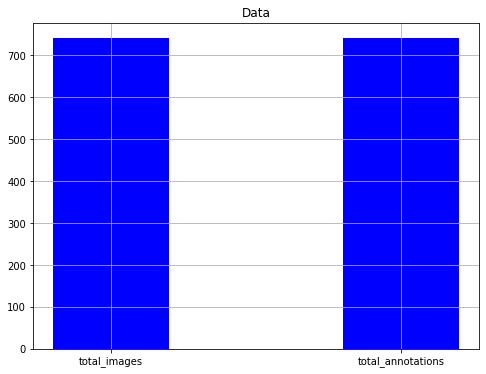

In [ ]:
#Showing graphically the number of images and annotation files
dict_={"total_images":len(images),"total_annotations":len(text_files)}
keys=dict_.keys()
values=dict_.values()

plt.figure(figsize=(8,6))
plt.bar(keys,values,width=0.4, color="blue")

plt.title("Data")
plt.grid()
plt.show()

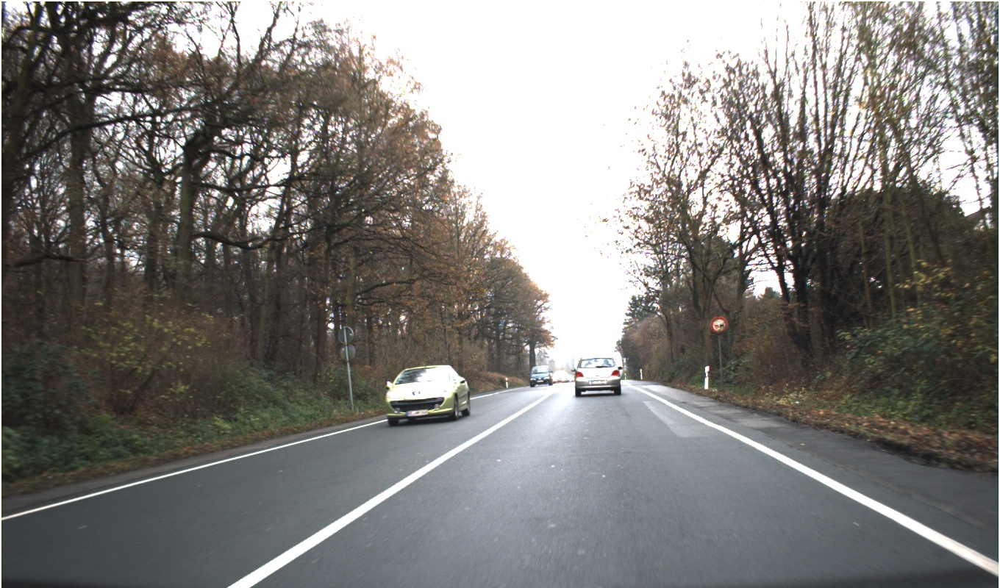

(800, 1360, 3)


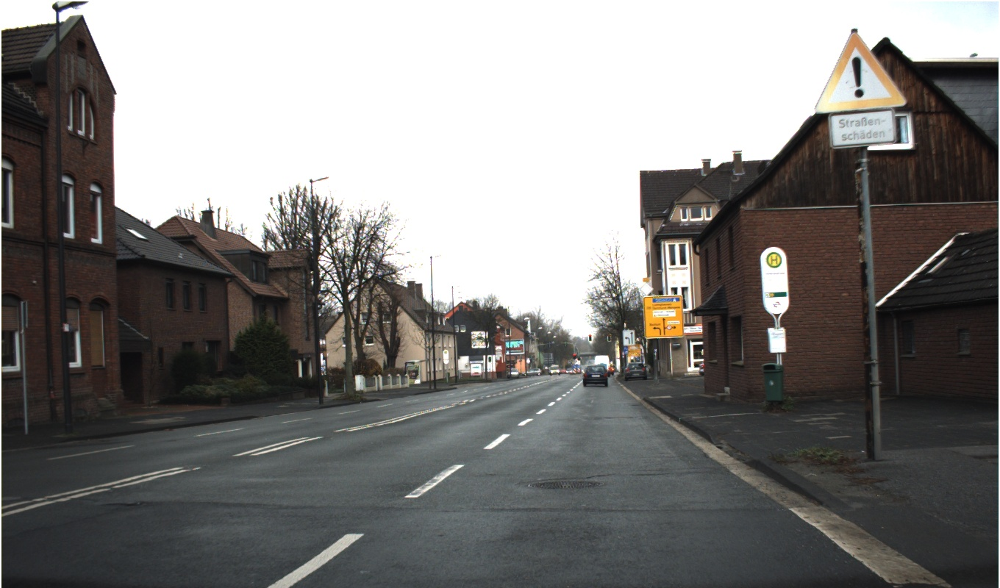

(800, 1360, 3)


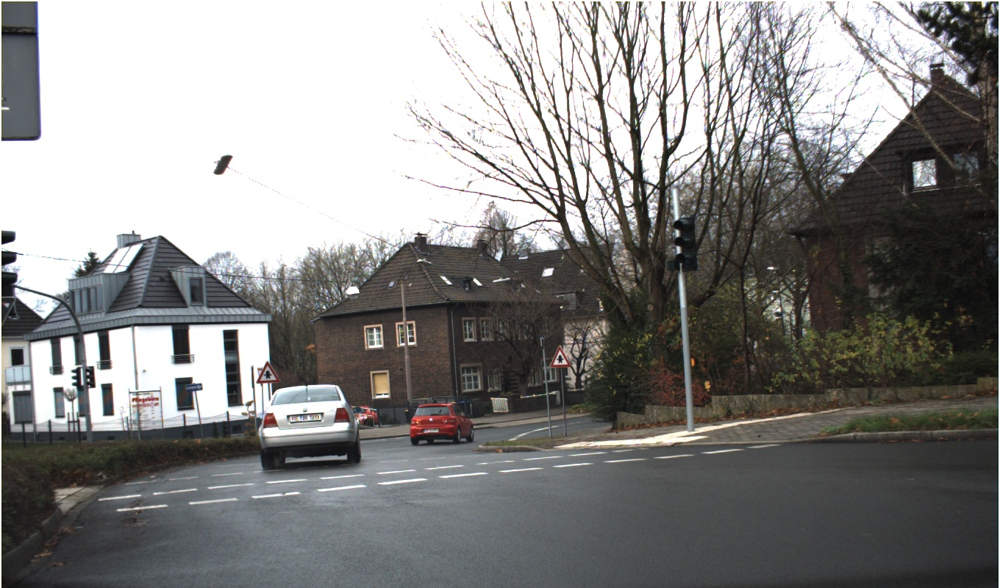

(800, 1360, 3)


In [ ]:
#displaying first three images from the data
#cv2.imshow() is disabled in Colab, because it causes Jupyter sessionsto crash so we imported cv2_imshow according to colab recommendation
from google.colab.patches import cv2_imshow
for i in images[0:3]:
  path=dataset_path + "/" + i #making the path of images
  im = cv2.imread(path)
  # displaying image
  cv2_imshow(im)
  print(im.shape)#checking the size of image

In [ ]:
text_files[0]

'00246.txt'

In [ ]:
#opening the annotation file from directory

ann_file_path=dataset_path + "/" + text_files[0]
file1 = open(ann_file_path, "r")

# Read the file
FileContent = file1.read()
FileContent

'0 0.24448529411764705 0.50375 0.03161764705882353 0.055\n0 0.8180147058823529 0.46875 0.03161764705882353 0.0525\n'

Above is the content of every file. In every line at first position label is given while at other four positions coordinates of the object are mentioned. We can see four classes in "classes.names" file in our dataset.(dataset_path="/content/gdrive/My Drive/Kaggle/traffic_signs_detection/ts/ts")

In [ ]:
#Now suppose we want to make 80% training and 20% validation sets

total_training_images=total_images * 0.8
total_val_images= total_images * 0.2

print(total_training_images)
print(total_val_images)

592.8000000000001
148.20000000000002


In [ ]:
#onverting in integers
total_training_images=int(total_training_images)
total_val_images=int(total_val_images)

print(f"No of training images: {total_training_images}")
print(f"No of test images: {total_val_images}")

No of training images: 592
No of test images: 148


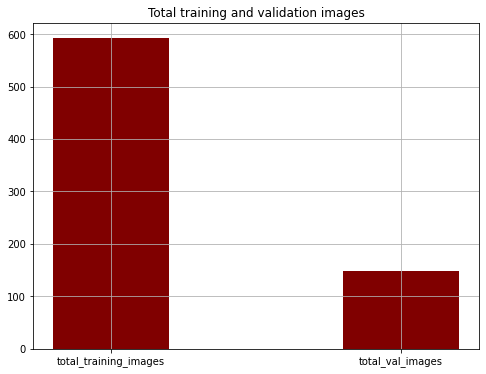

In [ ]:
#total number of training and validation images

dict1={"total_training_images":int(total_training_images),"total_val_images":int(total_val_images)}
keys=dict1.keys()
values=dict1.values()
                                 
plt.figure(figsize=(8,6))
plt.bar(keys,values,color ='maroon',
        width = 0.4)

plt.title("Total training and validation images")
plt.grid()
plt.show()

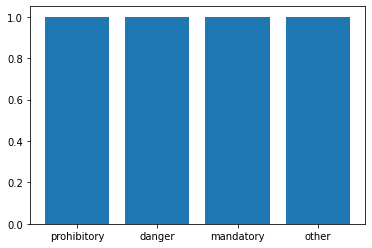

In [ ]:
#classes
total_classes=["prohibitory","danger","mandatory","other"]

plt.bar(total_classes,height=1)
plt.show()

In [ ]:
range(total_training_images)

range(0, 592)

In [ ]:
#randomly select images and put them to multiple folders i.e train,test,train labels and test labels.(We will get the labels from text file)
import os
import random
import shutil 
#import glob

#making directory of folders to save images and labels according to yolov5 requirements
#First we manually have to make folders in the drive.A data folder which have two folders known as images and labels. The image folder have further train and val folders
#while labels folder have further train and val folders
#Now mentioning the directory of the folders that we made manually
train_img="/content/gdrive/My Drive/Kaggle/traffic_signs_detection/data/images/train"
test_img="/content/gdrive/My Drive/Kaggle/traffic_signs_detection/data/images/val"
train_labels="/content/gdrive/My Drive/Kaggle/traffic_signs_detection/data/labels/train"
test_labels="/content/gdrive/My Drive/Kaggle/traffic_signs_detection/data/labels/val"

#making the folders for training set
for i in range(total_training_images):


  im_name=random.choice(images) # taking name of random image from image list
  shutil.copy(os.path.join(dataset_path,im_name),os.path.join(train_img,im_name))#copying from orignal folder to mentioned path
  images.remove(im_name)#removing the image from the list memory to prevent these images from copying again in validation set
  
  
  
  txtf_name=im_name[0:5]+".txt" #taking the name of corresponding(corresponding to the image(im_name)) text/annotation file  
  shutil.copy(os.path.join(dataset_path,txtf_name),os.path.join(train_labels,txtf_name))#copying from orignal folder to mentioned path
  text_files.remove(txtf_name)#removing the text file from the list memory to prevent these text files from copying again in validation set

In [ ]:
len(images)#we can check that copied images are removed from the list

149

In [ ]:
len(text_files)

149

In [ ]:
range(total_val_images)

range(0, 148)

In [ ]:

#making the folders for validation set
#making the folders for training set
#for j in range(total_training_images):

#  if len(images)>=2:



#    im_name=random.choice(images) # taking name of random image from image list
#    shutil.copy(os.path.join(dataset_path,im_name),os.path.join(test_img,im_name))#copying from orignal folder to mentioned path
#    images.remove(im_name)#removing the image from the list memory to prevent these images from copying again in test set
  
  
  
#    txtf_name=im_name[0:5]+".txt" #taking the name of corresponding(corresponding to the image(im_name)) text/annotation file  
#    shutil.copy(os.path.join(dataset_path,txtf_name),os.path.join(test_labels,txtf_name))#copying from orignal folder to mentioned path
#    text_files.remove(txtf_name)#removing the text file from the list memory to prevent these text files from copying again in test set

#  else:

#    #copying the remaining 1 images and text files in the required directory
#    for image in images:

#      shutil.copy(os.path.join(dataset_path,image),os.path.join(test_img,image))#copying from orignal folder to mentioned path

#    for file1 in text_files:
#      shutil.copy(os.path.join(dataset_path,file1),os.path.join(test_labels,file1))#copying from orignal folder to mentioned path


In [ ]:
#len(images)#to check that all files are copied or not

In [ ]:
#len(text_files)#to check that all files are copied or not

In [ ]:
#copying the remaining 149 images and text files in the required directory
for image in images:
  shutil.copy(os.path.join(dataset_path,image),os.path.join(test_img,image))#copying from orignal folder to mentioned path

for file1 in text_files:
  shutil.copy(os.path.join(dataset_path,file1),os.path.join(test_labels,file1))#copying from orignal folder to mentioned path





An important file is required to work with yolov5. We have given this file a name of "custom_data.yaml"(can give any name) file. After making this file we will place it in "yolov5/data/" directory. In this file we have to define the path of "train" and "val" images."nc" is number of classes and "names" is the list of names of different classes(You can see the format of this file in "yolov5/data/coco128.yaml" file ). In my case here is nc,names,train and val parameters of this file:

########Path of our training and validation immages

train: /content/gdrive/My Drive/Kaggle/traffic_signs_detection/data/images/train/

val: /content/gdrive/My Drive/Kaggle/traffic_signs_detection/data/images/val/

#######total classes(different calssis of traffic signs)

nc: 4
########names of those four classes

names: ["prohibitory","danger","mandatory","other"]



In [15]:
pwd #we have to work in yolov5 folder

'/content/gdrive/My Drive/Kaggle/traffic_signs_detection/yolov5'

In [16]:
ls #different folders in yolov5 folders

CONTRIBUTING.md  export.py   __pycache__/      train.py        yolov5s.pt
data/            hubconf.py  README.md         tutorial.ipynb
detect.py        LICENSE     requirements.txt  utils/
Dockerfile       models/     runs/             val.py


In [15]:
#We are working in yolov5 folder
#training our data
!python train.py --img 415 --batch 16 --epochs 70 --data custom_data.yaml --weights yolov5s.pt --cache

#train.py: is responsible for training algoritham on data. This file exist in yolov5 folder as we are working in this directory
#img 415:is size of image
#batch 16: is total number of batches
#epochs 50: 50 is number of epochs
#data data.yaml:data.yaml is our data.yaml file that exist in data folder. This file will give info of data i.e classes and data directory
#weights yolov5s.pt: Initially starting our training from pre trained weights. This file exists in yolov5 folder


train: weights=yolov5s.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=70, batch_size=16, imgsz=415, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 2021-10-6 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.5, shear

In [ ]:
In 70 epochs we got (result) 0.90 mAP.(By increasing size of image to 640 i got 0.97 mAP)

We can see our results in folder known as "runs" in yolov5 folder.There will be only "train" folder in "runs". After detecting/predicting there will have another folder created known as "detect" along with "train" folder. In the "train" folder we have "exp" folder created after training(1st time training:exp,2nd time training: exp2 and so on). Inside "exp" folder we have many results/files that we got after training. one of those there is a folder known as "weights". Inside this "weights" we have two files(best.pt & last.pt(we will use best.pt always)).We have got other files in "exp" folder after training."results.txt" file in "exp" folder contain results in every epoch(accu & loss). In "exp" folder there will be multiple pictures embedded in a single picture. These all multiple pictures in every single picture is one batch.Along this batch(picture) there is a same picture with predictions on it.

In [17]:
#checking our algo efficiecy graphically. We will print all graphs in run folder i.e in exp folder
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 665), started 0:00:35 ago. (Use '!kill 665' to kill it.)

<IPython.core.display.Javascript object>

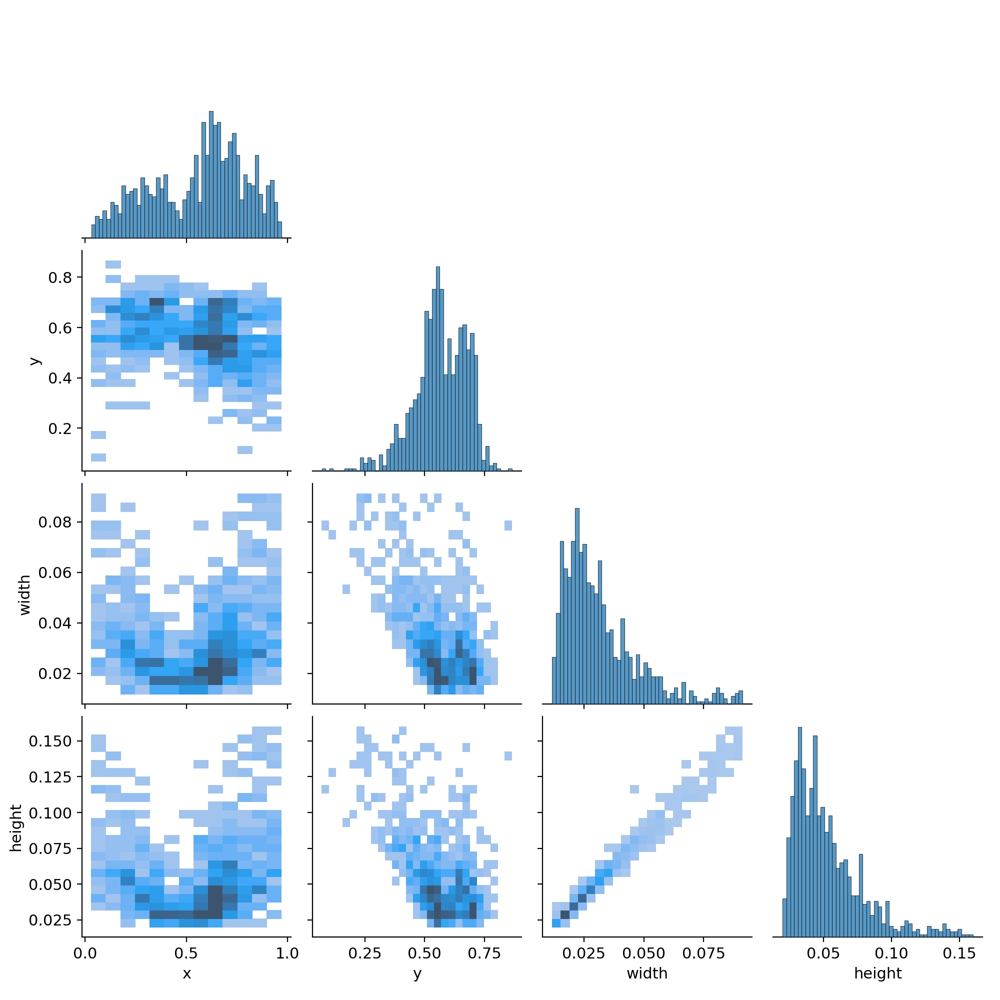

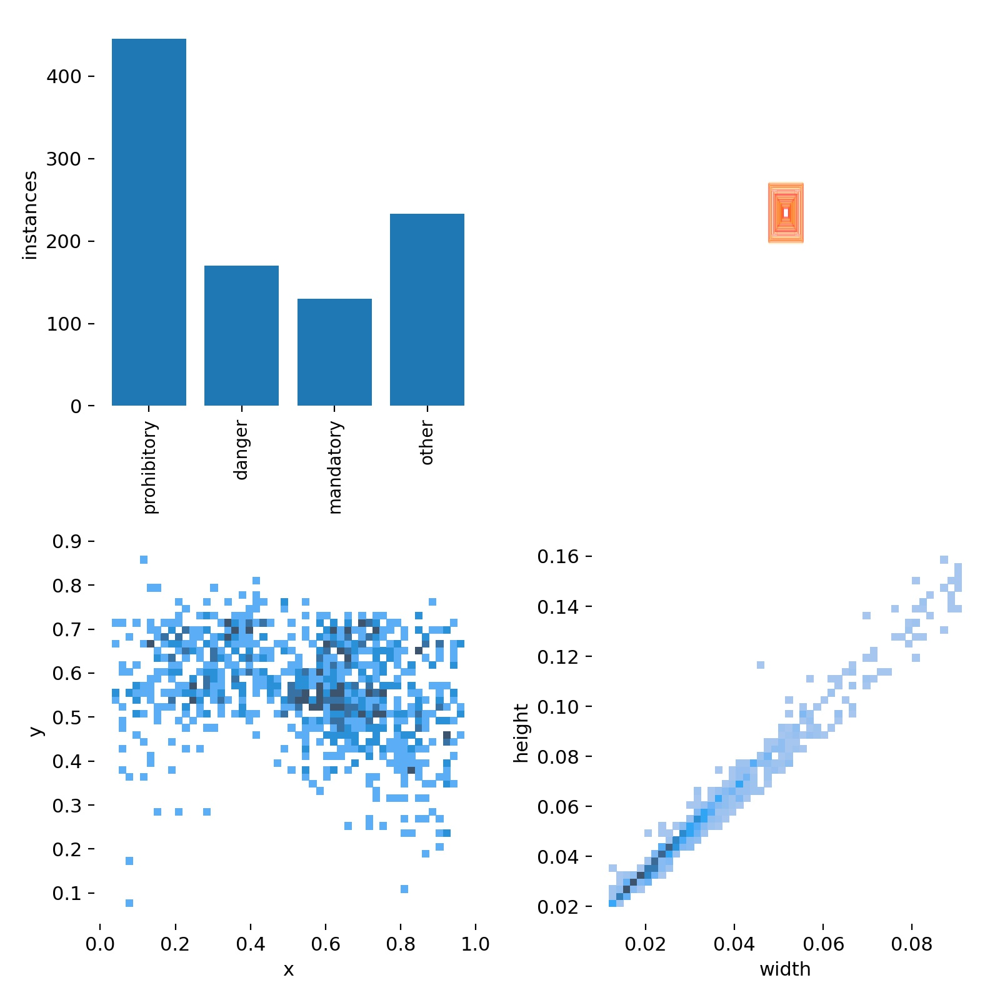

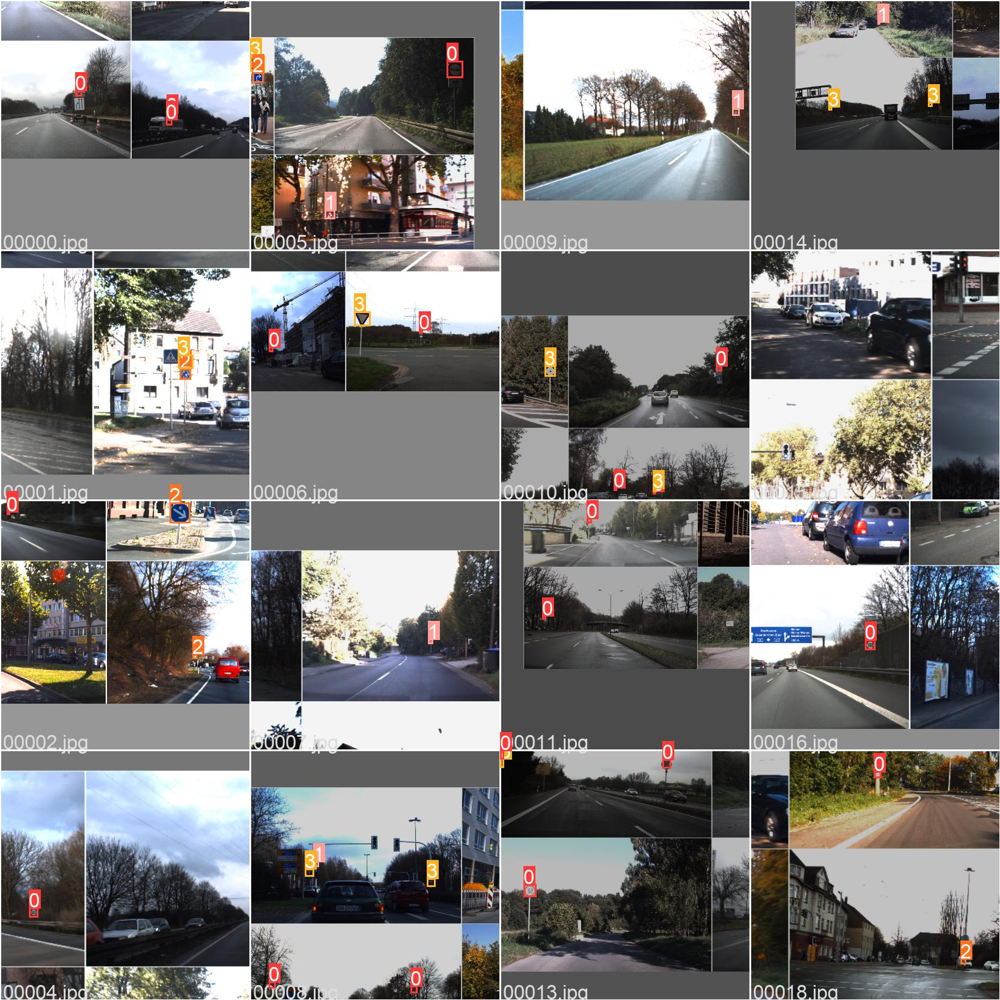

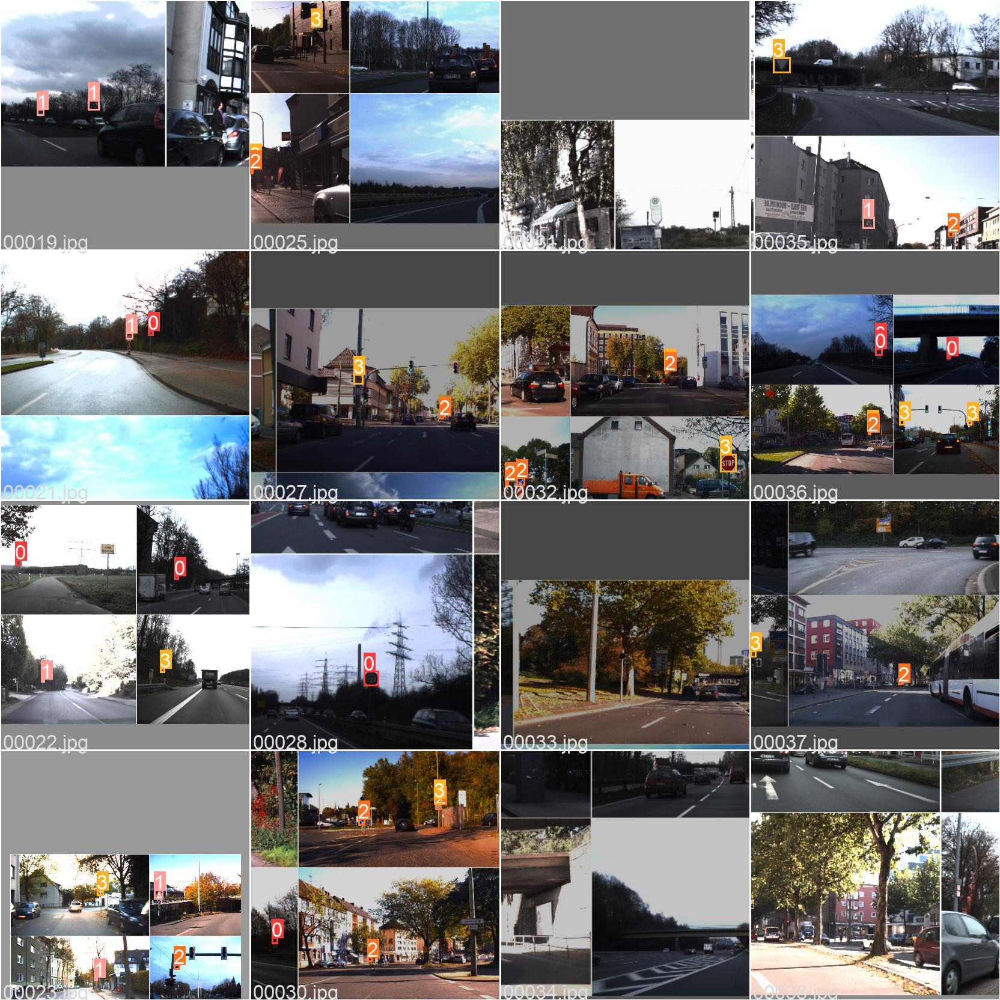

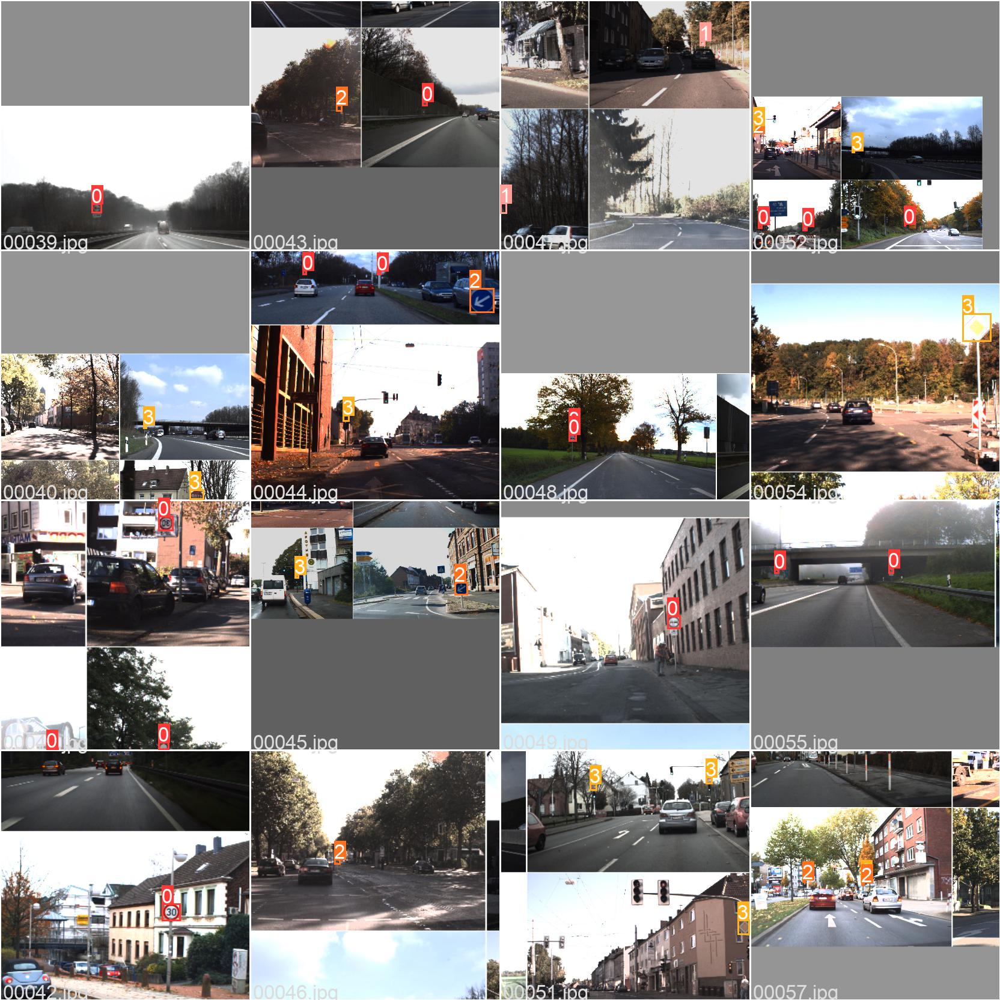

...

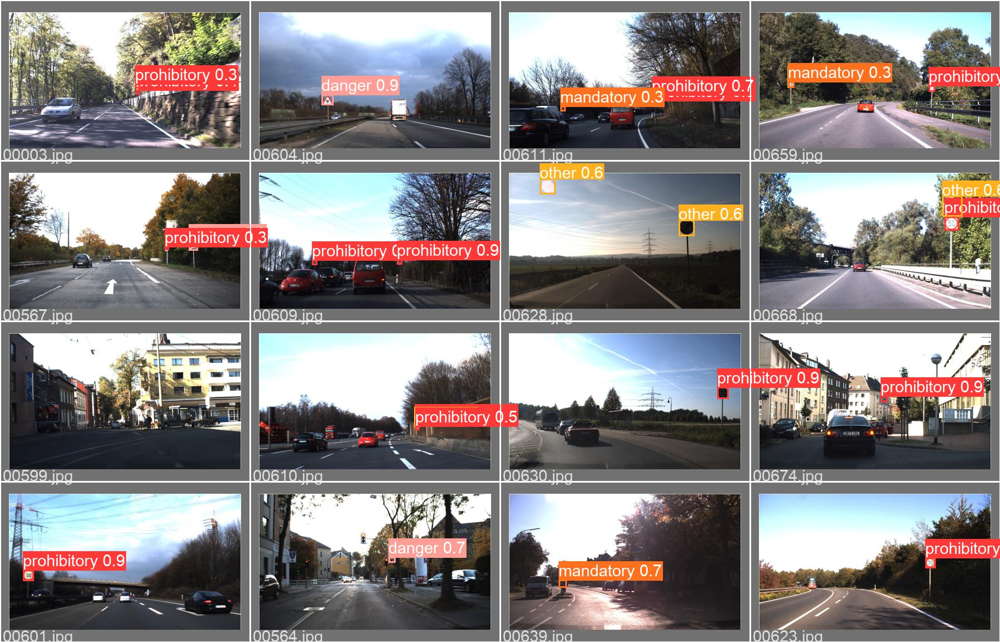

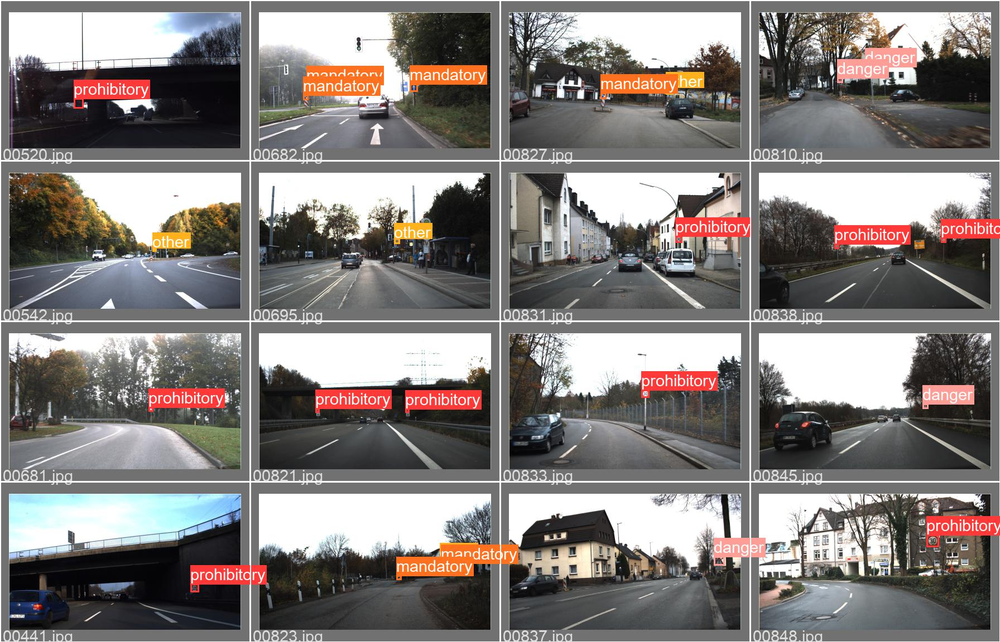

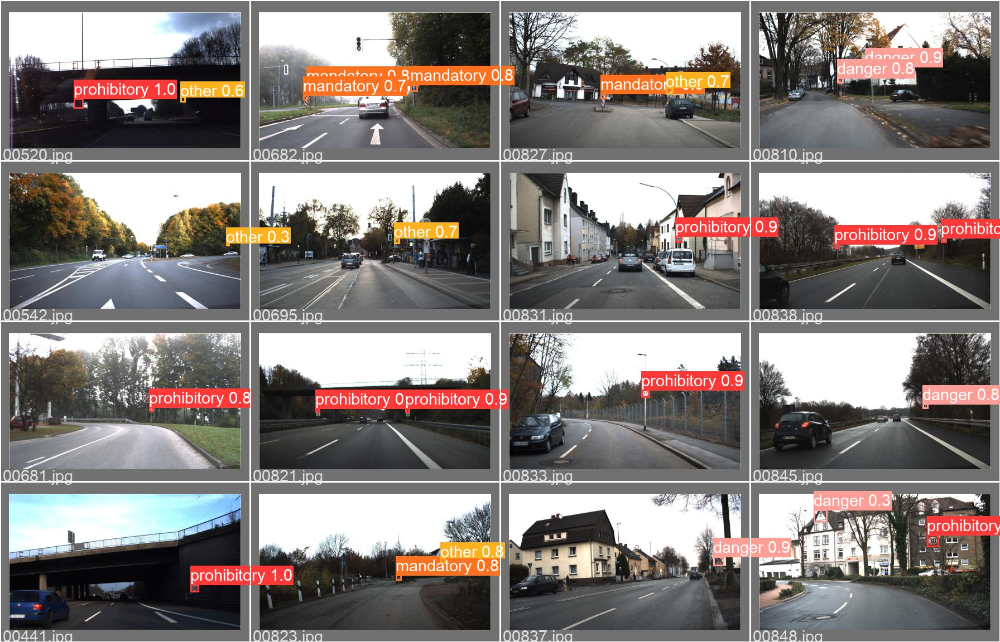

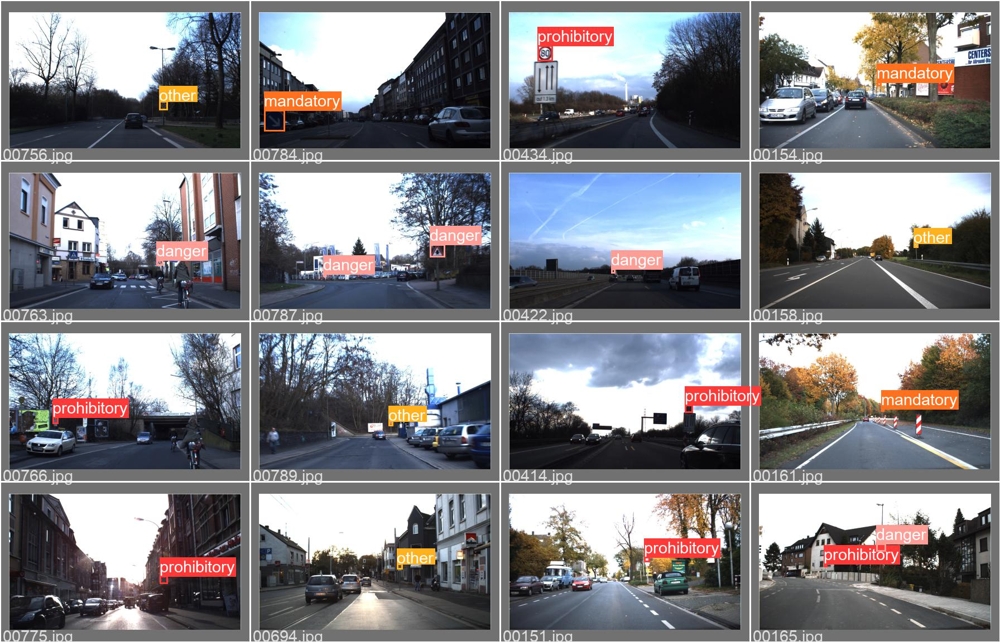

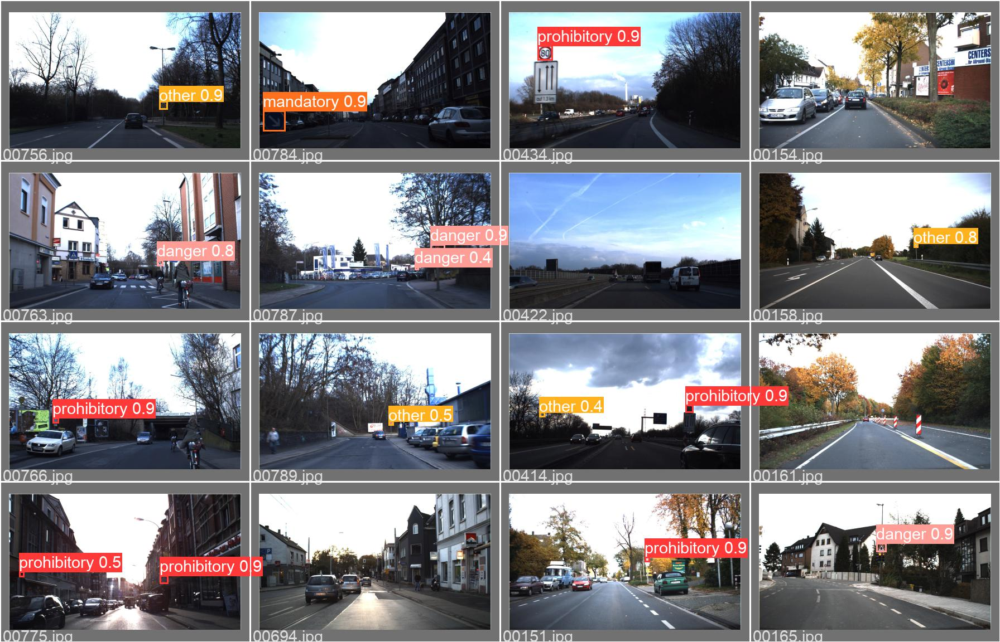

In [19]:
from google.colab.patches import cv2_imshow
im_path="/content/gdrive/My Drive/Kaggle/traffic_signs_detection/yolov5/runs/train/exp11/"
for file1 in os.listdir(im_path):
  if file1.endswith(".jpg"):
    path1=im_path+ "/" + file1
    #showing a batch of immage with labels from "exp" folder
    #Image(filename=path1,width=800)
    im1 = cv2.imread(path1)
    # displaying image
    cv2_imshow(im1)

In [18]:
#prediction
!python detect.py --weights runs/train/exp11/weights/best.pt --img 640 --conf 0.25 --source runs/speed_limit3.jpg
#In yolov5 folder we have detect.py folder which is responsible for detecting the objects.
#source is directory of our image/vedio. We want to predict the class of signs in that image
#weights: we have selected best weigts(for more info read the paragraph above). In "exp">"weights">"best.pt"

detect: weights=['runs/train/exp11/weights/best.pt'], source=runs/speed_limit3.jpg, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 2021-10-6 torch 1.9.0+cu102 CPU

Fusing layers... 
Model Summary: 224 layers, 7062001 parameters, 0 gradients
image 1/1 /content/gdrive/My Drive/Kaggle/traffic_signs_detection/yolov5/runs/speed_limit3.jpg: 416x640 4 prohibitorys, 3 mandatorys, Done. (0.300s)
Speed: 2.6ms pre-process, 299.9ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp4


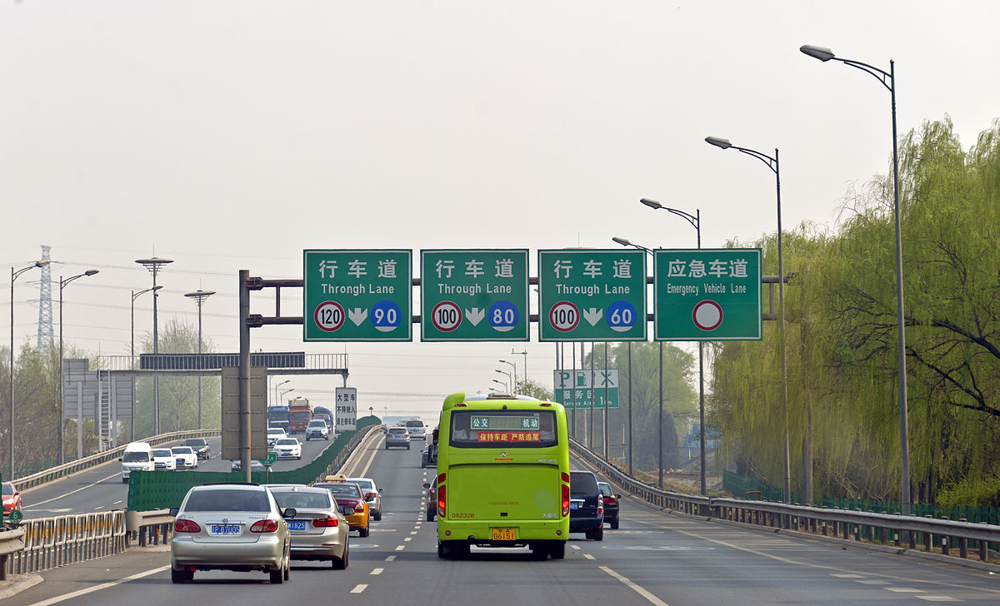

In [19]:
#showing the selected image for object detection test
Image(filename='runs/speed_limit3.jpg', width=600)

After running second last cell we can check the path where our results(image with object detected and labels) are saved. With running this cell our "detect" folder is created in folder "runs". In detect>exp folder(After running the above cell we can check the directory) we will have our results. Now we can show that image.

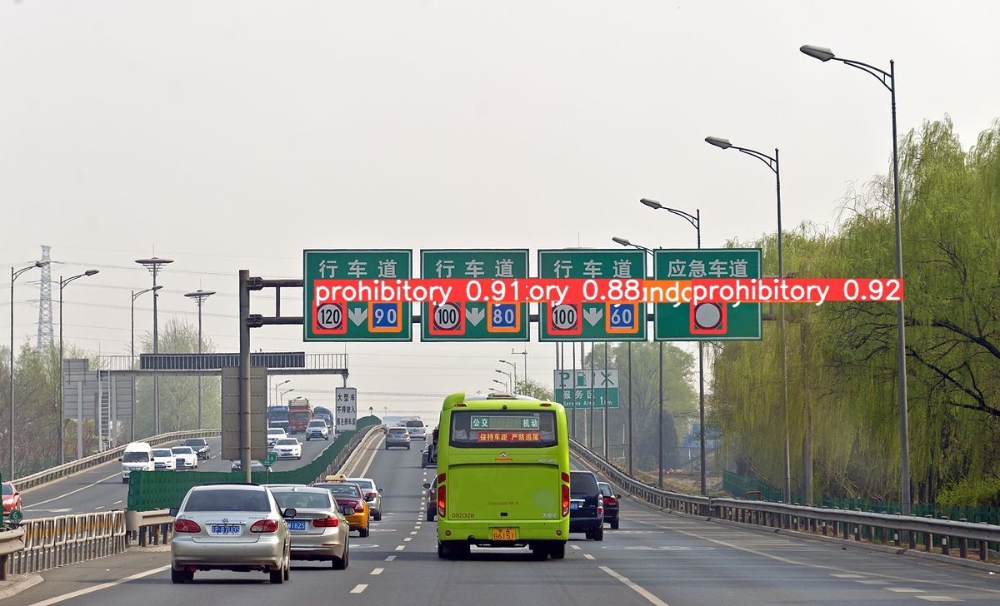

In [20]:
#showing the resulted image
Image(filename="runs/detect/exp4/speed_limit3.jpg",width=600)